In [1]:
# import libraries
import datetime
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling
from pandas_profiling.utils.cache import cache_file
%matplotlib inline

In [2]:
# load users data
users = pd.read_csv('/takehome_users.csv', encoding='latin-1')

In [3]:
# check a few rows
users.head()

,object_id,creation_time,name,email,creation_source,last_session_creation_time,opted_in_to_mailing_list,enabled_for_marketing_drip,org_id,invited_by_user_id
0,1,2014-04-22 03:53:30,Clausen August,AugustCClausen@yahoo.com,GUEST_INVITE,1.398139e+09,1,0,11,10803.0
1,2,2013-11-15 03:45:04,Poole Matthew,MatthewPoole@gustr.com,ORG_INVITE,1.396238e+09,0,0,1,316.0
2,3,2013-03-19 23:14:52,Bottrill Mitchell,MitchellBottrill@gustr.com,ORG_INVITE,1.363735e+09,0,0,94,1525.0
3,4,2013-05-21 08:09:28,Clausen Nicklas,NicklasSClausen@yahoo.com,GUEST_INVITE,1.369210e+09,0,0,1,5151.0
4,5,2013-01-17 10:14:20,Raw Grace,GraceRaw@yahoo.com,GUEST_INVITE,1.358850e+09,0,0,193,5240.0


In [4]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12000 entries, 0 to 11999
Data columns (total 10 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   object_id                   12000 non-null  int64  
 1   creation_time               12000 non-null  object 
 2   name                        12000 non-null  object 
 3   email                       12000 non-null  object 
 4   creation_source             12000 non-null  object 
 5   last_session_creation_time  8823 non-null   float64
 6   opted_in_to_mailing_list    12000 non-null  int64  
 7   enabled_for_marketing_drip  12000 non-null  int64  
 8   org_id                      12000 non-null  int64  
 9   invited_by_user_id          6417 non-null   float64
dtypes: float64(2), int64(4), object(4)
memory usage: 937.6+ KB


In [5]:
# convert 'creation_time' and 'last_session_creation_time' to datetime
users['creation_time'] = users['creation_time'].apply(pd.to_datetime)
users['last_session_creation_time'] = pd.to_datetime(users['last_session_creation_time'], unit = 's') # this is timedelta

In [6]:
users.head()

,object_id,creation_time,name,email,creation_source,last_session_creation_time,opted_in_to_mailing_list,enabled_for_marketing_drip,org_id,invited_by_user_id
0,1,2014-04-22 03:53:30,Clausen August,AugustCClausen@yahoo.com,GUEST_INVITE,2014-04-22 03:53:30,1,0,11,10803.0
1,2,2013-11-15 03:45:04,Poole Matthew,MatthewPoole@gustr.com,ORG_INVITE,2014-03-31 03:45:04,0,0,1,316.0
2,3,2013-03-19 23:14:52,Bottrill Mitchell,MitchellBottrill@gustr.com,ORG_INVITE,2013-03-19 23:14:52,0,0,94,1525.0
3,4,2013-05-21 08:09:28,Clausen Nicklas,NicklasSClausen@yahoo.com,GUEST_INVITE,2013-05-22 08:09:28,0,0,1,5151.0
4,5,2013-01-17 10:14:20,Raw Grace,GraceRaw@yahoo.com,GUEST_INVITE,2013-01-22 10:14:20,0,0,193,5240.0


In [7]:
# fill in missing values with '0'
users['invited_by_user_id'] = users['invited_by_user_id'].fillna(0)

In [8]:
# every user id > 0 set to 1, otherwise 0
users['invited_by_userid_new'] = np.where(users['invited_by_user_id'] > 0, 1, 0)

In [9]:
# verify the new column
users.head()

,object_id,creation_time,name,email,creation_source,last_session_creation_time,opted_in_to_mailing_list,enabled_for_marketing_drip,org_id,invited_by_user_id,invited_by_userid_new
0,1,2014-04-22 03:53:30,Clausen August,AugustCClausen@yahoo.com,GUEST_INVITE,2014-04-22 03:53:30,1,0,11,10803.0,1
1,2,2013-11-15 03:45:04,Poole Matthew,MatthewPoole@gustr.com,ORG_INVITE,2014-03-31 03:45:04,0,0,1,316.0,1
2,3,2013-03-19 23:14:52,Bottrill Mitchell,MitchellBottrill@gustr.com,ORG_INVITE,2013-03-19 23:14:52,0,0,94,1525.0,1
3,4,2013-05-21 08:09:28,Clausen Nicklas,NicklasSClausen@yahoo.com,GUEST_INVITE,2013-05-22 08:09:28,0,0,1,5151.0,1
4,5,2013-01-17 10:14:20,Raw Grace,GraceRaw@yahoo.com,GUEST_INVITE,2013-01-22 10:14:20,0,0,193,5240.0,1


In [11]:
users['invited_by_userid_new'].value_counts()

1    6417
0    5583
Name: invited_by_userid_new, dtype: int64

In [12]:
# fill in missing 'last_session_creation_time' with 'creation_time'
users['last_session_creation_time'] = users['last_session_creation_time'].fillna(users['creation_time'])

In [13]:
# check for missing values
missing = pd.concat([users.isnull().sum(), 100 * users.isnull().mean()], axis=1)
missing.columns = ['count', '%']
missing.sort_values(by='%', ascending=False)

,count,%
object_id,0,0.0
creation_time,0,0.0
name,0,0.0
email,0,0.0
creation_source,0,0.0
last_session_creation_time,0,0.0
opted_in_to_mailing_list,0,0.0
enabled_for_marketing_drip,0,0.0
org_id,0,0.0
invited_by_user_id,0,0.0


In [14]:
# load engagement data
engagement = pd.read_csv('/takehome_user_engagement.csv')

In [15]:
# check a few rows
engagement.head()

,time_stamp,user_id,visited
0,2014-04-22 03:53:30,1,1
1,2013-11-15 03:45:04,2,1
2,2013-11-29 03:45:04,2,1
3,2013-12-09 03:45:04,2,1
4,2013-12-25 03:45:04,2,1


In [16]:
# convert 'time_stamp' to datetime
engagement['time_stamp'] = engagement['time_stamp'].apply(pd.to_datetime)

In [17]:
engagement.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 207917 entries, 0 to 207916
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   time_stamp  207917 non-null  datetime64[ns]
 1   user_id     207917 non-null  int64         
 2   visited     207917 non-null  int64         
dtypes: datetime64[ns](1), int64(2)
memory usage: 4.8 MB


In [18]:
# rolling count of visited column for 7 days
engagement_by_group = pd.DataFrame(engagement.groupby('user_id').rolling('7D',
                                                                          on='time_stamp')['visited'].count()).reset_index()
engagement_by_group.head(10)

,user_id,time_stamp,visited
0,1,2014-04-22 03:53:30,1.0
1,2,2013-11-15 03:45:04,1.0
2,2,2013-11-29 03:45:04,1.0
3,2,2013-12-09 03:45:04,1.0
4,2,2013-12-25 03:45:04,1.0
5,2,2013-12-31 03:45:04,2.0
6,2,2014-01-08 03:45:04,1.0
7,2,2014-02-03 03:45:04,1.0
8,2,2014-02-08 03:45:04,2.0
9,2,2014-02-09 03:45:04,3.0


In [19]:
#labeling the adopted user as 1 wherever the visited column shows 3 or more visits
engagement_by_group['adopted_user'] = np.where(engagement_by_group['visited'] >= 3, 1, 0)

In [20]:
engagement_by_group.head()

,user_id,time_stamp,visited,adopted_user
0,1,2014-04-22 03:53:30,1.0,0
1,2,2013-11-15 03:45:04,1.0,0
2,2,2013-11-29 03:45:04,1.0,0
3,2,2013-12-09 03:45:04,1.0,0
4,2,2013-12-25 03:45:04,1.0,0


In [21]:
#group by user_id
adopted = pd.DataFrame(engagement_by_group.groupby('user_id')['adopted_user'].sum()>=1).reset_index()
adopted = adopted.astype('int64')
adopted.head()

,user_id,adopted_user
0,1,0
1,2,1
2,3,0
3,4,0
4,5,0


In [22]:
# merge both users and engagement dataframes
# and drop 'user_id'
df = pd.merge(users, adopted, how='left', left_on='object_id', right_on='user_id').drop(['user_id'], axis=1)
df.head()

,object_id,creation_time,name,email,creation_source,last_session_creation_time,opted_in_to_mailing_list,enabled_for_marketing_drip,org_id,invited_by_user_id,invited_by_userid_new,adopted_user
0,1,2014-04-22 03:53:30,Clausen August,AugustCClausen@yahoo.com,GUEST_INVITE,2014-04-22 03:53:30,1,0,11,10803.0,1,0.0
1,2,2013-11-15 03:45:04,Poole Matthew,MatthewPoole@gustr.com,ORG_INVITE,2014-03-31 03:45:04,0,0,1,316.0,1,1.0
2,3,2013-03-19 23:14:52,Bottrill Mitchell,MitchellBottrill@gustr.com,ORG_INVITE,2013-03-19 23:14:52,0,0,94,1525.0,1,0.0
3,4,2013-05-21 08:09:28,Clausen Nicklas,NicklasSClausen@yahoo.com,GUEST_INVITE,2013-05-22 08:09:28,0,0,1,5151.0,1,0.0
4,5,2013-01-17 10:14:20,Raw Grace,GraceRaw@yahoo.com,GUEST_INVITE,2013-01-22 10:14:20,0,0,193,5240.0,1,0.0


In [23]:
# check for missing values after merge
missing = pd.concat([df.isnull().sum(), 100 * df.isnull().mean()], axis=1)
missing.columns = ['count', '%']
missing.sort_values(by='%', ascending=False)

,count,%
adopted_user,3177,26.475
object_id,0,0.000
creation_time,0,0.000
name,0,0.000
email,0,0.000
creation_source,0,0.000
last_session_creation_time,0,0.000
opted_in_to_mailing_list,0,0.000
enabled_for_marketing_drip,0,0.000
org_id,0,0.000


In [24]:
# fill in missing values in 'adopted_user' with '0'
df['adopted_user'] = df['adopted_user'].fillna(0)

In [25]:
# check for missing values after merge
missing = pd.concat([df.isnull().sum(), 100 * df.isnull().mean()], axis=1)
missing.columns = ['count', '%']
missing.sort_values(by='%', ascending=False)

,count,%
object_id,0,0.0
creation_time,0,0.0
name,0,0.0
email,0,0.0
creation_source,0,0.0
last_session_creation_time,0,0.0
opted_in_to_mailing_list,0,0.0
enabled_for_marketing_drip,0,0.0
org_id,0,0.0
invited_by_user_id,0,0.0


In [26]:
# extract Month , Day , Year , 'Day of Week', 'Week of Year', 'Hour', 'Minute' and 'Seconds' from the Date field
df['creation_time_Month'] = df.creation_time.dt.month
df['creation_time_Day'] = df.creation_time.dt.day
df['creation_time_Year'] = df.creation_time.dt.year
df['creation_time_Week Number'] = df.creation_time.dt.isocalendar().week 
df['creation_time_Day Of Week'] = df.creation_time.dt.dayofweek
df['creation_time_Day Name']= pd.to_datetime(df['creation_time']).dt.day_name() 
df['creation_time_Month Name']=pd.to_datetime(df['creation_time']).dt.month_name()
df['creation_time_Hour'] = df.creation_time.dt.hour
df['creation_time_Minute'] = df.creation_time.dt.minute
df['creation_time_Second'] = df.creation_time.dt.second

In [27]:
# extract Month , Day , Year , 'Day of Week', 'Week of Year', 'Hour', 'Minute' and 'Seconds' from the Date field
df['last_session_Month'] = df.last_session_creation_time.dt.month
df['last_session_Day'] = df.last_session_creation_time.dt.day
df['last_session_Year'] = df.last_session_creation_time.dt.year
df['last_session_Week Number'] = df.last_session_creation_time.dt.isocalendar().week 
df['last_session_Day Of Week'] = df.last_session_creation_time.dt.dayofweek
df['last_session_Day Name']= pd.to_datetime(df['last_session_creation_time']).dt.day_name() 
df['last_session_Month Name']=pd.to_datetime(df['last_session_creation_time']).dt.month_name()
df['last_session_Hour'] = df.last_session_creation_time.dt.hour
df['last_session_Minute'] = df.last_session_creation_time.dt.minute
df['last_session_Second'] = df.last_session_creation_time.dt.second

In [28]:
# get differenece between last_sessiomn_creation_time_day and creation_time_day
df['creation_diff'] = df['last_session_Day'] - df['creation_time_Day']

In [29]:
df.head()

,object_id,creation_time,name,email,creation_source,last_session_creation_time,opted_in_to_mailing_list,enabled_for_marketing_drip,org_id,invited_by_user_id,...,last_session_Day,last_session_Year,last_session_Week Number,last_session_Day Of Week,last_session_Day Name,last_session_Month Name,last_session_Hour,last_session_Minute,last_session_Second,creation_diff
0,1,2014-04-22 03:53:30,Clausen August,AugustCClausen@yahoo.com,GUEST_INVITE,2014-04-22 03:53:30,1,0,11,10803.0,...,22,2014,17,1,Tuesday,April,3,53,30,0
1,2,2013-11-15 03:45:04,Poole Matthew,MatthewPoole@gustr.com,ORG_INVITE,2014-03-31 03:45:04,0,0,1,316.0,...,31,2014,14,0,Monday,March,3,45,4,16
2,3,2013-03-19 23:14:52,Bottrill Mitchell,MitchellBottrill@gustr.com,ORG_INVITE,2013-03-19 23:14:52,0,0,94,1525.0,...,19,2013,12,1,Tuesday,March,23,14,52,0
3,4,2013-05-21 08:09:28,Clausen Nicklas,NicklasSClausen@yahoo.com,GUEST_INVITE,2013-05-22 08:09:28,0,0,1,5151.0,...,22,2013,21,2,Wednesday,May,8,9,28,1
4,5,2013-01-17 10:14:20,Raw Grace,GraceRaw@yahoo.com,GUEST_INVITE,2013-01-22 10:14:20,0,0,193,5240.0,...,22,2013,4,1,Tuesday,January,10,14,20,5


In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12000 entries, 0 to 11999
Data columns (total 33 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   object_id                   12000 non-null  int64         
 1   creation_time               12000 non-null  datetime64[ns]
 2   name                        12000 non-null  object        
 3   email                       12000 non-null  object        
 4   creation_source             12000 non-null  object        
 5   last_session_creation_time  12000 non-null  datetime64[ns]
 6   opted_in_to_mailing_list    12000 non-null  int64         
 7   enabled_for_marketing_drip  12000 non-null  int64         
 8   org_id                      12000 non-null  int64         
 9   invited_by_user_id          12000 non-null  float64       
 10  invited_by_userid_new       12000 non-null  int64         
 11  adopted_user                12000 non-null  float64   

In [31]:
df['opted_in_to_mailing_list'].value_counts(normalize=True)

0    0.7505
1    0.2495
Name: opted_in_to_mailing_list, dtype: float64

We see from the result above 25% of users opted in to mailing list

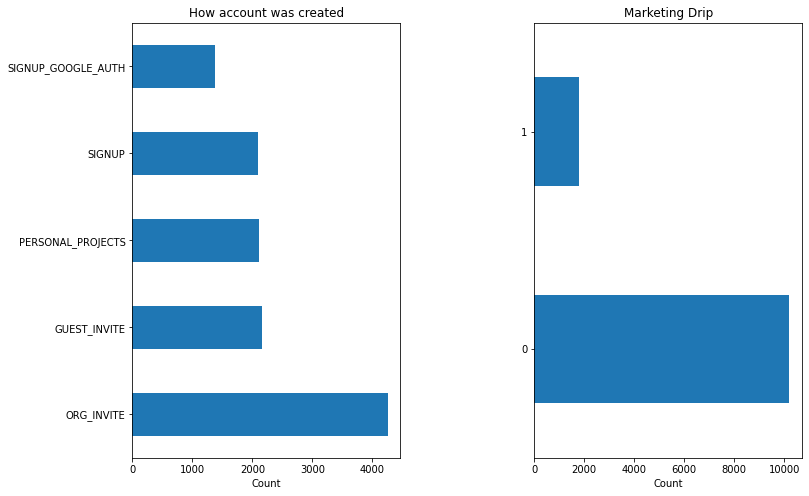

In [32]:
#Create two subplots on 1 row and 2 columns with a figsize of (12, 8)
fig, ax = plt.subplots(1, 2, figsize=(12,8))
df['creation_source'].value_counts().plot(kind='barh', ax=ax[0])
ax[0].set_title('How account was created')
ax[0].set_xlabel('Count')

#Specify a horizontal barplot ('barh') as kind of plot (kind=)
df['enabled_for_marketing_drip'].value_counts().plot(kind='barh', ax=ax[1])
ax[1].set_title('Marketing Drip')
ax[1].set_xlabel('Count')

#Give the subplots a little "breathing room" with a wspace of 0.5
plt.subplots_adjust(wspace=0.5);

Invited to an organization (as a full member) seem to be dominant in how the account was created with over 4000 users. Just a handfull also opted in to receive marketing emails. How can the company increase that number?

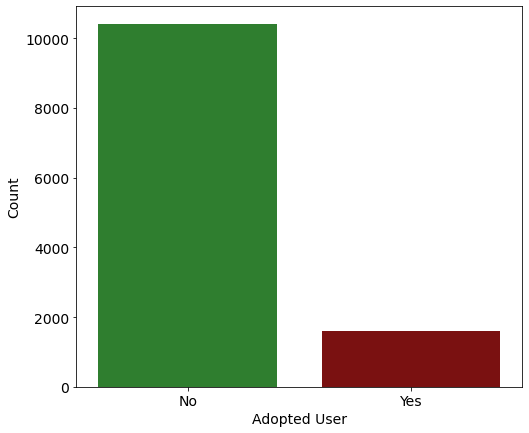

In [33]:
# distribution of target variable 'adopted_user'
plt.figure(figsize=(8,7))
sns.countplot(x='adopted_user', data=df, palette=['forestgreen', 'darkred'])
plt.xticks([0,1], ['No', 'Yes'], fontsize= 14, color='black')
plt.yticks(fontsize= 14, color='black')
plt.xlabel('Adopted User', fontsize=14, color='black')
plt.ylabel('Count',fontsize=14, color='black')
plt.show()

In [34]:
df['adopted_user'].value_counts(normalize=True)

0.0    0.8665
1.0    0.1335
Name: adopted_user, dtype: float64

Less users were adopted. There seems to be an imbalanced user adoption.

In [35]:
# distribution of source of account and adopted _user
acount_user = df.groupby(['creation_source', 'adopted_user']).size().unstack()

<AxesSubplot:title={'center':'Account creation source and those who actually looged into the product'}, ylabel='creation_source'>

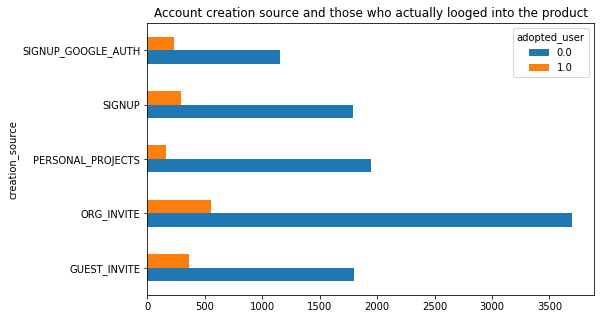

In [37]:
fig,ax = plt.subplots(1,1,figsize=(8,5))
acount_user.plot(ax=ax,kind='barh',title='Account creation source and those who actually looged into the product')

Most people invited to an organization as a full member are more likely to be aodpted as compared to the other account creation source. However, they are also more likely not to be adopted.

In [38]:
# distribution report for all features
report = df.profile_report(sort='None', html={'style':{'full_width': True}}, progress_bar=False)
report

In [39]:
# drop columns
cols = ['creation_time', 'last_session_creation_time', 'name', 'email', 'object_id', 'org_id', 'invited_by_user_id']
df = df.drop(columns=cols, axis=1)

In [40]:
# target and features
X = df.drop(columns=['adopted_user'], axis=1)
y = df['adopted_user']

# create dummy features for X
X = pd.get_dummies(X, drop_first=True)

In [41]:
# import libraries
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, learning_curve, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,roc_auc_score,recall_score
from sklearn.metrics import accuracy_score,log_loss
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
import datetime
import lightgbm as lgb
from bayes_opt import BayesianOptimization

# split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [42]:
# scale training and test set
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [43]:
# fit a dummy classifier
strategies = ['most_frequent', 'stratified', 'uniform'] 

test_scores = []
test_prob = []
for s in strategies:
    dum_clf = DummyClassifier(strategy=s, random_state=42)
    dum_clf.fit(X_train_scaled, y_train)
    score = dum_clf.score(X_test_scaled, y_test)
    y_pred = dum_clf.predict_proba(X_test_scaled)
    test_prob.append(y_pred)
    test_scores.append(score)

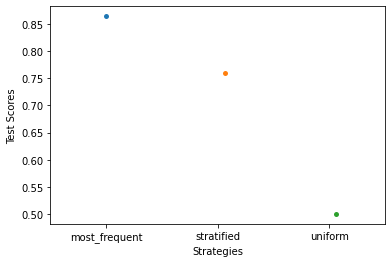

In [44]:
# plot scores against the strategies
ax = sns.stripplot(x=strategies, y=test_scores)
ax.set_xlabel('Strategies')
ax.set_ylabel('Test Scores')
plt.show()

In [45]:
# instantiate RandomForestClassifier
rf_clf = RandomForestClassifier(n_estimators=100, max_depth=None, random_state=42)

# fit to the training set
rf_clf.fit(X_train_scaled, y_train)

# predict on the test set
y_pred_rf = rf_clf.predict(X_test_scaled)

# check accuracy score
print(accuracy_score(y_pred_rf, y_test))

0.969


In [46]:
# create hyperparameter
param_grid = {'n_estimators': [50, 100, 200, 500, 1000],
                    'max_depth': [4, 5, 6, 7, 8, 10]}

# instantiate randomforestclassifier
rf_clf2 = RandomForestClassifier()

# create Randomizedsearch with 5-fold
rf_cv = RandomizedSearchCV(rf_clf2, param_grid, n_iter=15, cv=5, random_state=42)

# fit to the training set
best_model = rf_cv.fit(X_train_scaled, y_train)

# best hyperparameter values
print('Tuned Random Forest Parameters: {}'.format(best_model.best_params_))
print('Tuned GridSearch Random Forest Accuracy: {}'.format(best_model.best_score_))

Tuned Random Forest Parameters: {'n_estimators': 200, 'max_depth': 10}
Tuned GridSearch Random Forest Accuracy: 0.9641111111111111


In [47]:
# train and fit best parameters 
rf_best = RandomForestClassifier(n_estimators=200, max_depth=10)

# fit to the training set
rf_best.fit(X_train_scaled, y_train)

# predict on test set
y_pred_rf2 = rf_best.predict(X_test_scaled)

# check accuracy score
print(accuracy_score(y_pred_rf2, y_test))

0.9653333333333334


Accuracy = 0.97
Recall = 0.94



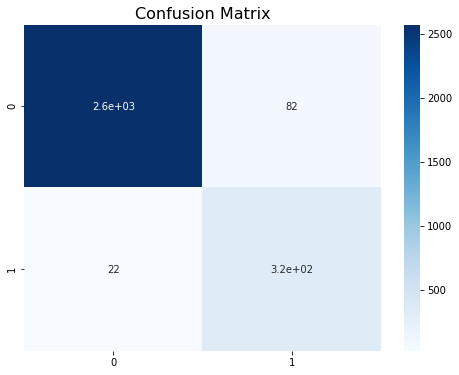

In [48]:
# confusion matrix
print(f'Accuracy = {accuracy_score(y_pred_rf2, y_test):.2f}\nRecall = {recall_score(y_pred_rf2, y_test):.2f}\n')
cm = confusion_matrix(y_pred_rf2, y_test)
plt.figure(figsize=(8, 6))
plt.title('Confusion Matrix', size=16)
sns.heatmap(cm, annot=True, cmap='Blues');

In [49]:
# feature importance
rf_importances = pd.DataFrame({'feature':X_train.columns,'importance':np.round(rf_best.feature_importances_,3)})
rf_importances = rf_importances.sort_values('importance',ascending=False).set_index('feature')
rf_importances.head(20)

,importance
feature,
creation_diff,0.158
last_session_Week Number,0.098
creation_time_Week Number,0.088
last_session_Year,0.084
creation_time_Month,0.074
last_session_Month,0.064
creation_time_Year,0.060
last_session_Day,0.054
last_session_Month Name_June,0.052


In [50]:
# instantiate the XGBClassifier
xg_boost = XGBClassifier(random_state=42, use_label_encoder=False, n_estimators=50, learning_rate=0.05)

# fit to the train set
xg_model = xg_boost.fit(X_train_scaled, y_train)

# predict on the test set
y_pred_xg = xg_model.predict(X_test_scaled)

# check for accuracy
print(accuracy_score(y_pred_xg, y_test))

0.959


In [51]:
# fine tune and train the model
from scipy import stats
from sklearn.model_selection import KFold

# create hyperparemeter
param_dist = {'n_estimators': stats.randint(50, 500),
              'learning_rate': stats.uniform(0.01, 0.6)
             }

# instantiate
xg_boost2 = XGBClassifier(objective = 'binary:logistic')

# create RandomizedSearch with 5 fold cv
numFolds = 5
kfold_5 = KFold(shuffle = True, n_splits = numFolds)
xg_cv = RandomizedSearchCV(xg_boost2, 
                         param_distributions = param_dist,
                         cv = kfold_5,  
                         n_iter = 10, 
                         scoring = 'roc_auc', 
                         error_score = 0, 
                         verbose = 3, 
                         n_jobs = -1
                                    )
# fit to the training set
best_model = xg_cv.fit(X_train_scaled, y_train)

# best hyperparameter values
print('Tuned XGBoost Parameters: {}'.format(best_model.best_params_))
print('Tuned XGBoost Accuracy: {}'.format(best_model.best_score_))

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Tuned XGBoost Parameters: {'learning_rate': 0.10220976006132124, 'n_estimators': 314}
Tuned XGBoost Accuracy: 0.9924094036222456


In [52]:
# train and fit the best parameters
xg_best = XGBClassifier(objective = 'binary:logistic', learning_rate=0.10220976006132124, n_estimators=314)

# fit to the training set
xg_best.fit(X_train_scaled, y_train)

# predict on the test set
y_pred_xg2 = xg_best.predict(X_test_scaled)

# check for accuracy
print(accuracy_score(y_pred_xg2, y_test))

0.975


Accuracy = 0.97
Recall = 0.93



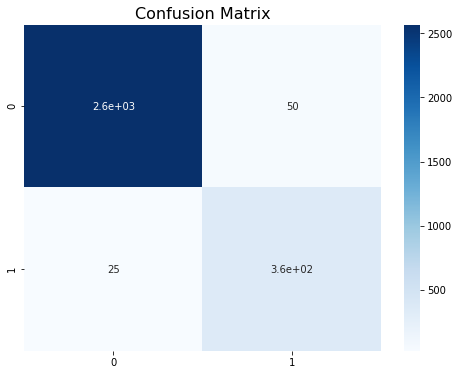

In [53]:
# confusion matrix
print(f'Accuracy = {accuracy_score(y_pred_xg2, y_test):.2f}\nRecall = {recall_score(y_pred_xg2, y_test):.2f}\n')
cm = confusion_matrix(y_pred_xg2, y_test)
plt.figure(figsize=(8, 6))
plt.title('Confusion Matrix', size=16)
sns.heatmap(cm, annot=True, cmap='Blues');

In [54]:
# feature importance
importances = pd.DataFrame({'feature':X_train.columns,'importance':np.round(xg_best.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False).set_index('feature')
importances.head(20)

,importance
feature,
creation_time_Year,0.157
last_session_Month Name_June,0.147
creation_diff,0.118
creation_time_Month Name_May,0.115
last_session_Month Name_May,0.095
last_session_Year,0.061
creation_time_Month,0.028
last_session_Month Name_July,0.026
last_session_Week Number,0.024


In [64]:
from imblearn.over_sampling import SMOTE 

X = X.astype('int64')
sm = SMOTE(random_state=42)

X_sm, y_sm = sm.fit_resample(X, y)

print(f'''Shape of X before SMOTE: {X.shape}
Shape of X after SMOTE: {X_sm.shape}''')

print('\nBalance of positive and negative classes (%):')
y_sm.value_counts(normalize=True) * 100

Shape of X before SMOTE: (12000, 58)
Shape of X after SMOTE: (20796, 58)

Balance of positive and negative classes (%):


0    50.0
1    50.0
Name: adopted_user, dtype: float64

0.9813425658780535
Accuracy = 0.98
Recall = 0.99



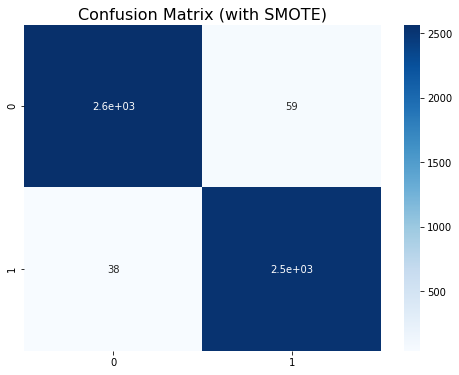

In [65]:
X_train_sm, X_test_sm, y_train_sm, y_test_sm = train_test_split(
    X_sm, y_sm, test_size=0.25, random_state=42
)

# scale training and test set
scaler = StandardScaler()
scaler.fit(X_train_sm)
X_train_scaled_sm = scaler.transform(X_train_sm)
X_test_scaled_sm = scaler.transform(X_test_sm)

# instantiate RandomForestClassifier
rf_clf1 = RandomForestClassifier(n_estimators=100, max_depth=None, random_state=42)

# fit to the training set
rf_clf1.fit(X_train_scaled_sm, y_train_sm)

# predict on the test set
y_pred_rf1 = rf_clf1.predict(X_test_scaled_sm)

# check accuracy score
print(accuracy_score(y_pred_rf1, y_test_sm))

print(f'Accuracy = {accuracy_score(y_test_sm, y_pred_rf1):.2f}\nRecall = {recall_score(y_test_sm, y_pred_rf1):.2f}\n')
cm = confusion_matrix(y_test_sm, y_pred_rf1)
plt.figure(figsize=(8, 6))
plt.title('Confusion Matrix (with SMOTE)', size=16)
sns.heatmap(cm, annot=True, cmap='Blues');

In [66]:
# feature importance
rf1_importances = pd.DataFrame({'feature':X_train_sm.columns,'importance':np.round(rf_clf1.feature_importances_,3)})
rf1_importances = rf1_importances.sort_values('importance',ascending=False).set_index('feature')
rf1_importances.head(20)

,importance
feature,
creation_diff,0.157
last_session_Week Number,0.111
last_session_Year,0.094
last_session_Month,0.085
creation_time_Week Number,0.076
creation_time_Month,0.061
creation_time_Year,0.049
last_session_Month Name_June,0.041
creation_time_Month Name_May,0.037


The final model chosen will be the `RandomForest` model. There was an issue of imbalanced dataset in the sense that the target variable `adopted_user` had about 87% saying `no` and 13% saying `yes`. The `RandomForest` model had an accuracy of 97% and recall of 94%. Meaning it classified 6% of those who said `no` as `yes`. After applying SMOTE in order not to avoiding, the accuracy of model increased by 1% and the recall increased by 5%(only 1% was misclassified).

The top 5 feature importance from the model;
* `creation_diff`
* `last_session_Week Number`
* `creation_time_Week Number`
* `last_session_Year`
* `last_session_Month`

From here, we can see that the difference between `creation_time`(when the account was created) and `last_session_creation_time` plays an important in predicting future user adoption.